# 9. Image Matching

## Table of Contents
1. [Libraries](#libraries)
1. [ORB Matching](#orb)
1. [SIFT Matching](#sift)

## Importing Libraries <a class="anchor" id="libraries" ></a>

In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

In [2]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


# ORB (Oriented FAST and Rotated BRIEF) <a class="anchor" id="orb" ></a>

- Developed at OpenCV labs by Ethan Rublee, Vincent Rabaud, Kurt Konolige, and Gary R. Bradski in 2011
- Efficient and viable alternative to SIFT and SURF (patented algorithms)
- ORB is free to use
- Feature detection
- ORB builds on FAST keypoint detector + BRIEF descriptor

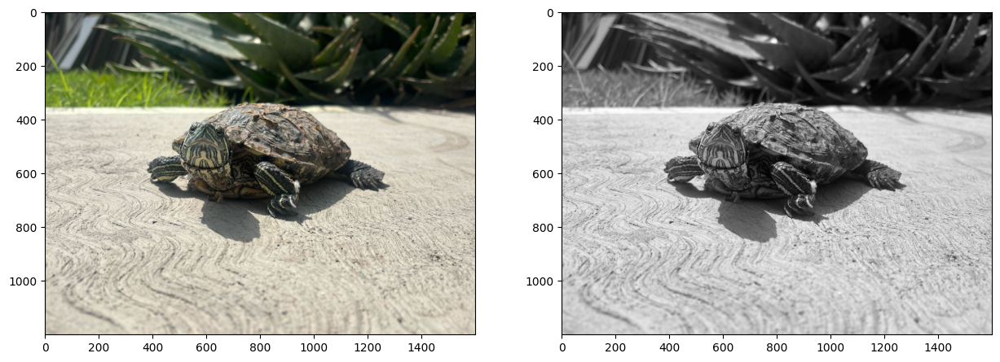

In [3]:
#reading image
img = cv2.imread('/content/drive/MyDrive/VisionComp_Imagenes/data/tortu_1.jpeg')
img_color = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_color)
plt.subplot(1, 2, 2)
plt.imshow(img_gray, cmap="gray")

### Create test image by adding Scale Invariance and Rotational Invariance

In [4]:
test_image = cv2.pyrDown(img_color)
test_image = cv2.pyrDown(test_image)
num_rows, num_cols = test_image.shape[:2]

rotation_matrix = cv2.getRotationMatrix2D((num_cols/2, num_rows/2), 30, 1)
test_image = cv2.warpAffine(test_image, rotation_matrix, (num_cols, num_rows))

test_gray = cv2.cvtColor(test_image, cv2.COLOR_RGB2GRAY)

### Display traning image and testing image

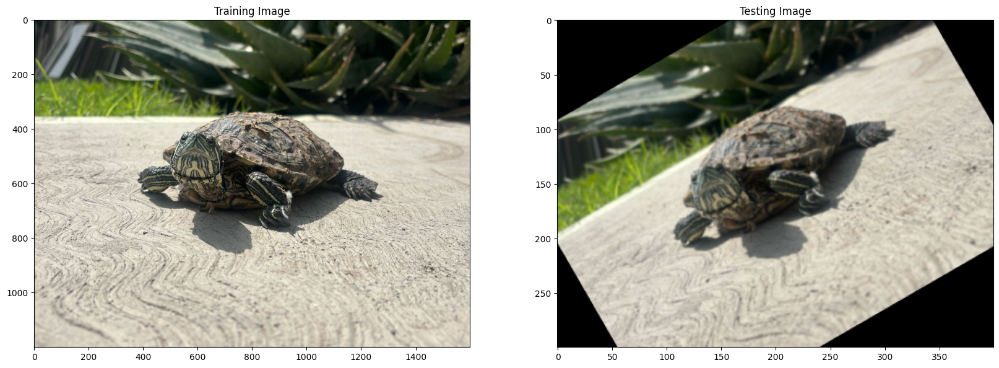

In [5]:
fx, plots = plt.subplots(1, 2, figsize=(20,10))

plots[0].set_title("Training Image")
plots[0].imshow(img_color)

plots[1].set_title("Testing Image")
plots[1].imshow(test_image)

### ORB

In [6]:
orb = cv2.ORB_create()

Number of Keypoints Detected In The Training Image:  500
Number of Keypoints Detected In The Query Image:  498


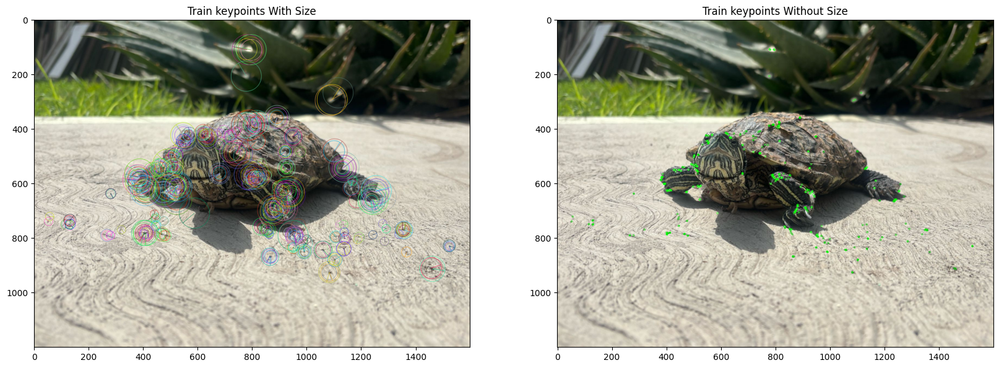

In [7]:
train_keypoints, train_descriptor = orb.detectAndCompute(img_color, None)
test_keypoints, test_descriptor = orb.detectAndCompute(test_gray, None)

keypoints_without_size = np.copy(img_color)
keypoints_with_size = np.copy(img_color)

cv2.drawKeypoints(img_color, train_keypoints, keypoints_without_size, color = (0, 255, 0))

cv2.drawKeypoints(img_color, train_keypoints, keypoints_with_size, flags = cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# Display image with and without keypoints size
fx, plots = plt.subplots(1, 2, figsize=(20,10))

plots[0].set_title("Train keypoints With Size")
plots[0].imshow(keypoints_with_size, cmap='gray')

plots[1].set_title("Train keypoints Without Size")
plots[1].imshow(keypoints_without_size, cmap='gray')

# Print the number of keypoints detected in the training image
print("Number of Keypoints Detected In The Training Image: ", len(train_keypoints))

# Print the number of keypoints detected in the query image
print("Number of Keypoints Detected In The Query Image: ", len(test_keypoints))

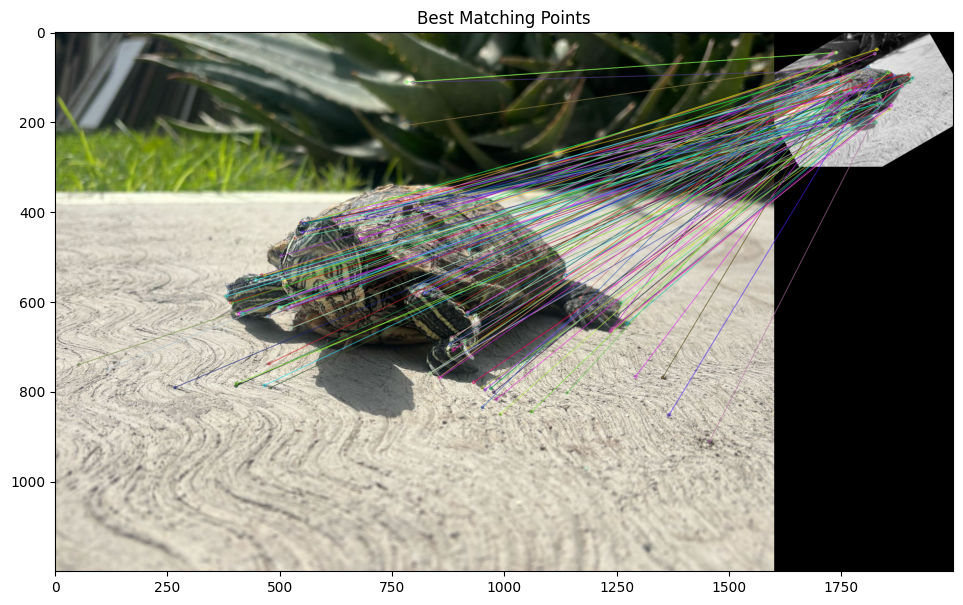


Number of Matching Keypoints Between The Training and Query Images:  147


In [8]:

# Create a Brute Force Matcher object.
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck = True)

# Perform the matching between the ORB descriptors of the training image and the test image
matches = bf.match(train_descriptor, test_descriptor)

# The matches with shorter distance are the ones we want.
matches = sorted(matches, key = lambda x : x.distance)

result = cv2.drawMatches(img_color, train_keypoints, test_gray, test_keypoints, matches, test_gray, flags = 2)

# Display the best matching points
plt.rcParams['figure.figsize'] = [14.0, 7.0]
plt.title('Best Matching Points')
plt.imshow(result)
plt.show()

# Print total number of matching points between the training and query images
print("\nNumber of Matching Keypoints Between The Training and Query Images: ", len(matches))

## SIFT Matching (Scale Invariant Feature Transform) <a class="anchor" id="sift" ></a>

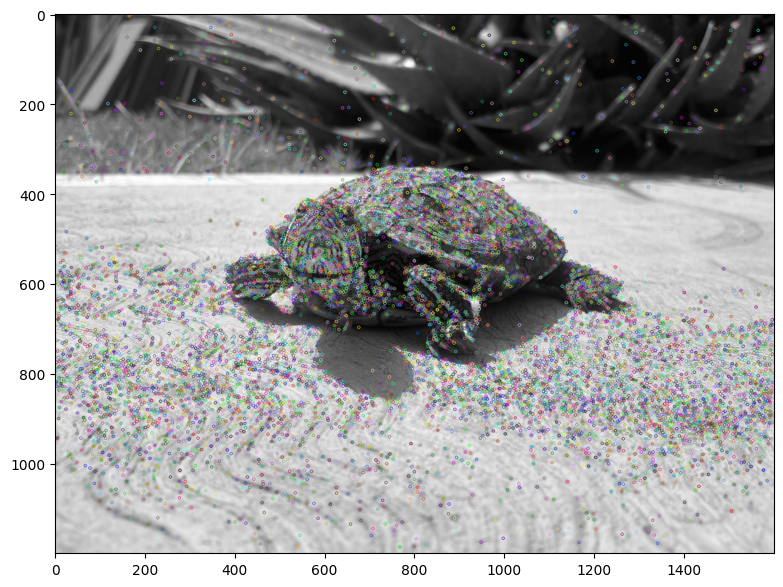

In [9]:
img1 = cv2.imread('/content/drive/MyDrive/VisionComp_Imagenes/data/tortu_1.jpeg')
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)

#keypoints
sift = cv2.SIFT_create()
keypoints_1, descriptors_1 = sift.detectAndCompute(img1,None)

img_1 = cv2.drawKeypoints(gray1,keypoints_1,img1)
plt.imshow(img_1)

### Matching different images

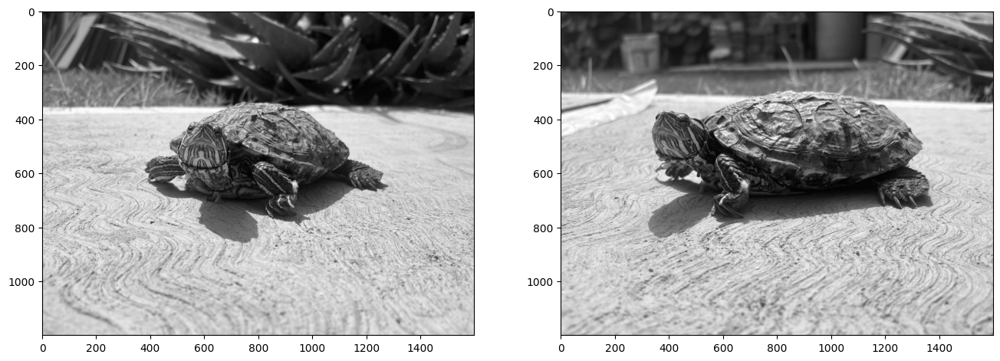

In [10]:
# read images
img1 = cv2.imread('/content/drive/MyDrive/VisionComp_Imagenes/data/tortu_1.jpeg')
img2 = cv2.imread('/content/drive/MyDrive/VisionComp_Imagenes/data/tortu_2.jpeg')

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

figure, ax = plt.subplots(1, 2, figsize=(16, 8))

ax[0].imshow(img1, cmap='gray')
ax[1].imshow(img2, cmap='gray')

### Extracting Keypoints with SIFT

In [11]:
#sift
sift = cv2.SIFT_create()

keypoints_1, descriptors_1 = sift.detectAndCompute(img1,None)
keypoints_2, descriptors_2 = sift.detectAndCompute(img2,None)

len(keypoints_1), len(keypoints_2)

(11267, 12715)

### Feature Matching

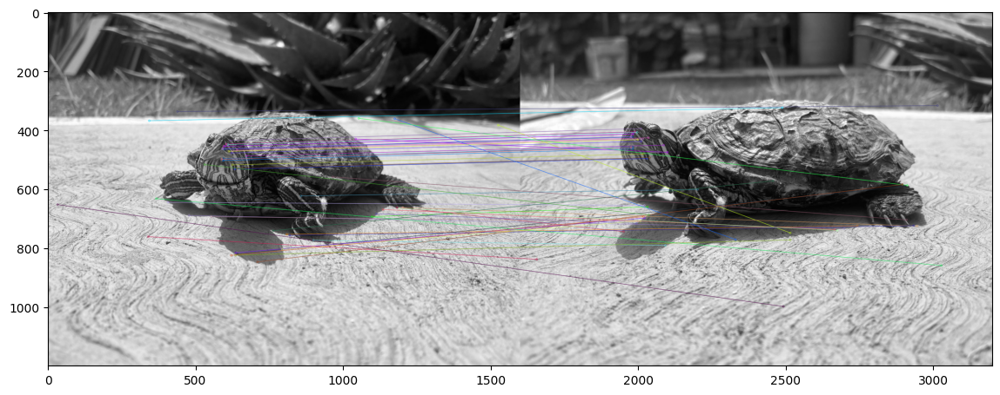

(<matplotlib.image.AxesImage at 0x7af1b01352d0>, None)

In [12]:
#feature matching
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)

matches = bf.match(descriptors_1,descriptors_2)
matches = sorted(matches, key = lambda x:x.distance)

img3 = cv2.drawMatches(img1, keypoints_1, img2, keypoints_2, matches[:50], img2, flags=2)
plt.imshow(img3),plt.show()

# Ejercicio.

Importamos las imagenes de tortuga e intentamos analizar las lineas tendencias y similitudes.

## Contexto de las imagenes a analizar.
Una vez que ya hemos visto un poco sobre que trata el algoritmo de Harris. Podemos empezar a plantear y testear el algoritmo en diferentes imagenes.

Las imagenes a analizar son fotografias tomadas de mi Tortuga mascota el día 15 de Febrero de 2025. Fueron tomadas el medio día usando mi celular.

Las imagenes presentaran retos como veremos más adelante porque son fotografias en diferentes angulos, algunas tomadas en el patio, otras tomadas en el interior de la casa, unas con exposicion al sol y otras en la sonbra al interior de la casa. Al ser un animal vivo es imposible que permanezca estatico, lo cual significa un reto al usar el método porque las posturas serán diferentes.

A continuación se despliegan las imagenes:

In [13]:
# Importamos las 6 imagenes capturadas.
my_img1= cv2.imread('/content/drive/MyDrive/VisionComp_Imagenes/data/tortu_1.jpeg')
my_img2= cv2.imread('/content/drive/MyDrive/VisionComp_Imagenes/data/tortu_2.jpeg')
my_img3= cv2.imread('/content/drive/MyDrive/VisionComp_Imagenes/data/tortu_3.jpeg')
my_img4= cv2.imread('/content/drive/MyDrive/VisionComp_Imagenes/data/tortu_4.jpeg')
my_img5= cv2.imread('/content/drive/MyDrive/VisionComp_Imagenes/data/tortu_5.jpeg')
my_img6= cv2.imread('/content/drive/MyDrive/VisionComp_Imagenes/data/tortu_6.jpeg')

# Cargamos las mismas imagenes pero en escala de grises.
my_img1= cv2.cvtColor(my_img1, cv2.COLOR_BGR2GRAY)
my_img2= cv2.cvtColor(my_img2, cv2.COLOR_BGR2GRAY)
my_img3= cv2.cvtColor(my_img3, cv2.COLOR_BGR2GRAY)
my_img4= cv2.cvtColor(my_img4, cv2.COLOR_BGR2GRAY)
my_img5= cv2.cvtColor(my_img5, cv2.COLOR_BGR2GRAY)
my_img6= cv2.cvtColor(my_img6, cv2.COLOR_BGR2GRAY)

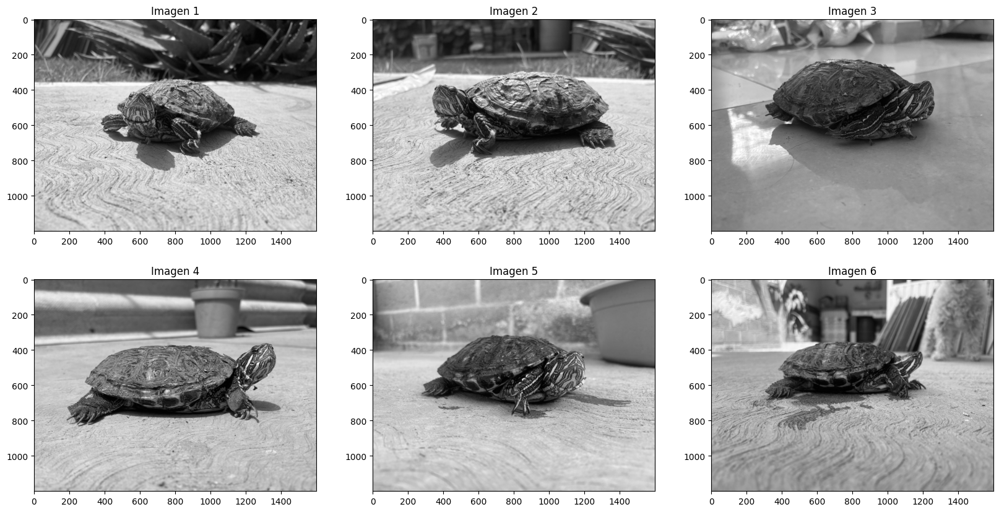

In [14]:
# guardamos las imagnes en una lista
images = [my_img1, my_img2, my_img3, my_img4, my_img5, my_img6]

# Imprimimos nuestras imagenes.
plt.figure(figsize=(20, 10))
for i in range(len(images)):
    plt.subplot(2, 3, i+1)
    plt.imshow(images[i], cmap='gray')
    plt.title(f'Imagen {i+1}')

# Analísis de SIFT.

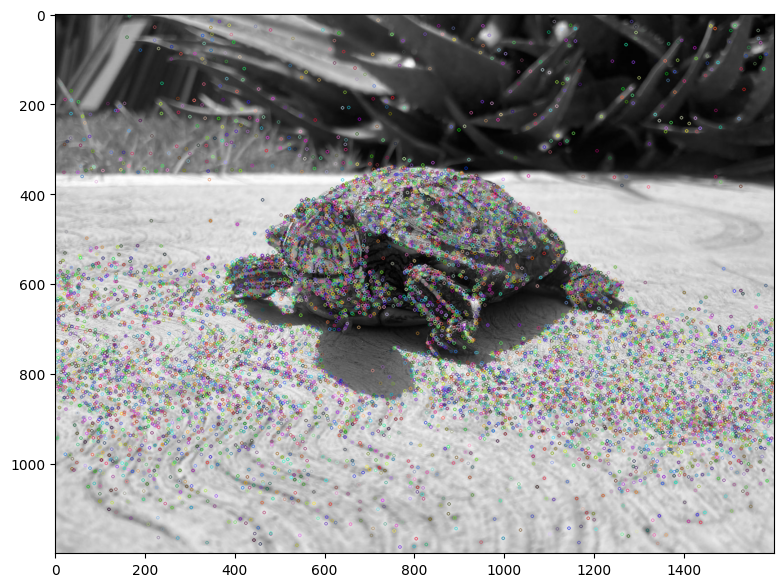

In [15]:
# Importamos la primera imagen.
img_tr = images[0]

# Creación del objeto.
sift = cv2.SIFT_create()
# Obtenemos las caractetisticas y descripciones del algoritmo SIFT
keypoints_SIFT, descriptors_SIFT = sift.detectAndCompute(img_tr,None)
# Iluminamos los puntos principales.
img_SIFT = cv2.drawKeypoints(img_tr,keypoints_SIFT,img_tr)
plt.imshow(img_SIFT)

**Comentarios:** Podemos observar en la imagen de salida que muchos puntos del contorno son detectados, pero no solo ellos sino también puntos alrededor donde también existen bordes pronunciados.

1ra comparación.

In [16]:
# Definición de imagen de comparación (query)
img_query = images[1]

# Creación de Descriptores para comparación
sift = cv2.SIFT_create()

# Extracción de caracteristicas
keypoints_1, descriptors_1 = sift.detectAndCompute(img_query,None)
keypoints_2, descriptors_2 = sift.detectAndCompute(img_tr,None)
len(keypoints_1), len(keypoints_2)

(12715, 11267)

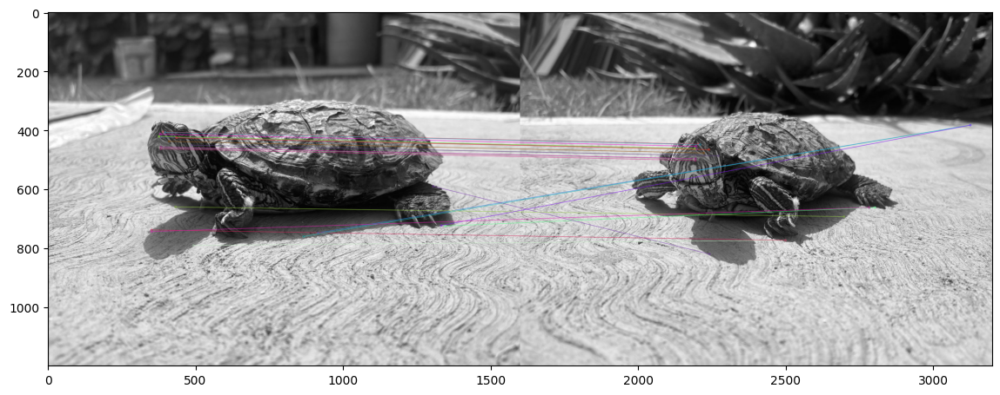

(<matplotlib.image.AxesImage at 0x7af18c24f7d0>, None)

In [17]:
#feature matching
bf = cv2.BFMatcher()
# Instanciación del objeto y extracción de caracteristicas.
matches = bf.match(descriptors_1,descriptors_2)
matches = sorted(matches, key = lambda x:x.distance)
# Resultados.
img_match_SIFT_1 = cv2.drawMatches(img_query, keypoints_1, img_tr, keypoints_2, matches[:20], img_tr, flags=2)
plt.imshow(img_match_SIFT_1),plt.show()

**Comentarios:** Observamos que hay detalles que se mapean muy bien, principalmente los de la cara pero también hay asociaciones equivocadas como en la que asocia una esquina del patio con una garra.

2da comparación.

In [18]:
# Definición de imagen de comparación (query)
img_query = images[2]

# Creación de Descriptores
sift = cv2.SIFT_create()
# Instanciamos descriptores.
keypoints_1, descriptors_1 = sift.detectAndCompute(img_query,None)
keypoints_2, descriptors_2 = sift.detectAndCompute(img_tr,None)
len(keypoints_1), len(keypoints_2)

(3503, 11267)

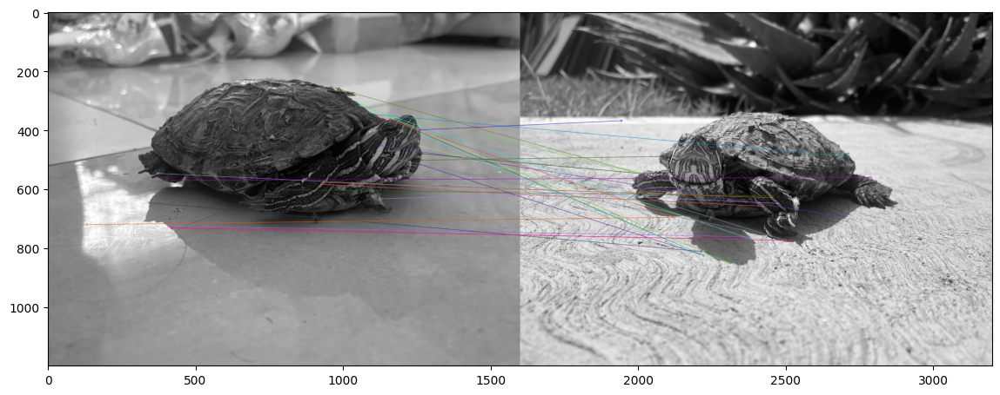

(<matplotlib.image.AxesImage at 0x7af18c2652d0>, None)

In [19]:
#feature matching
bf = cv2.BFMatcher()
# Instanciamos las caracteristicas del objeto.
matches = bf.match(descriptors_1,descriptors_2)
matches = sorted(matches, key = lambda x:x.distance)
# Visualizamos imagen.
img_match_SIFT_2 = cv2.drawMatches(img_query, keypoints_1, img_tr, keypoints_2, matches[:30], img_tr, flags=2)
plt.imshow(img_match_SIFT_2),plt.show()

**Comentarios:** Con una imagen con otro tipo de iluminación y de entorno diferente las diferencias son más notirias hay puntos de similitud acertados pero la mayoria no lo son.

3ra Comparación.

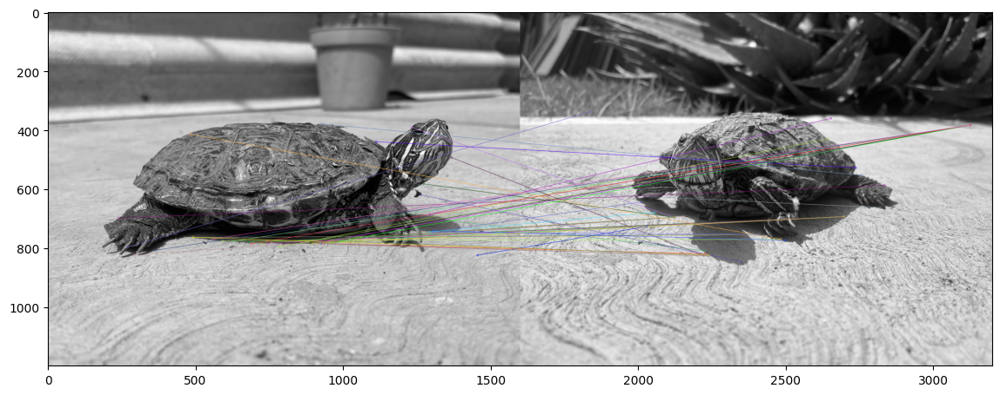

(<matplotlib.image.AxesImage at 0x7af1b024e950>, None)

In [20]:
# Definición de imagen de comparación (query)
img_query = images[3]

# Creación de Descriptores
sift = cv2.SIFT_create()
# Descripción de propiedades
keypoints_1, descriptors_1 = sift.detectAndCompute(img_query,None)
keypoints_2, descriptors_2 = sift.detectAndCompute(img_tr,None)

#feature matching
bf = cv2.BFMatcher()

matches = bf.match(descriptors_1,descriptors_2)
matches = sorted(matches, key = lambda x:x.distance)

img_match_SIFT_3 = cv2.drawMatches(img_query, keypoints_1, img_tr, keypoints_2, matches[:50], img_tr, flags=2)
plt.imshow(img_match_SIFT_3),plt.show()

**Comentarios:** Imagenes tomadas en el mismo patio pero en diferente angulo y dferente posición, las diferencias son en este caso mayores, pues se asocia la esquina de una imagen con partes inferiores de la mascota otro punto es que la sombra de la tortuta es detectada.

4ta Comparación.

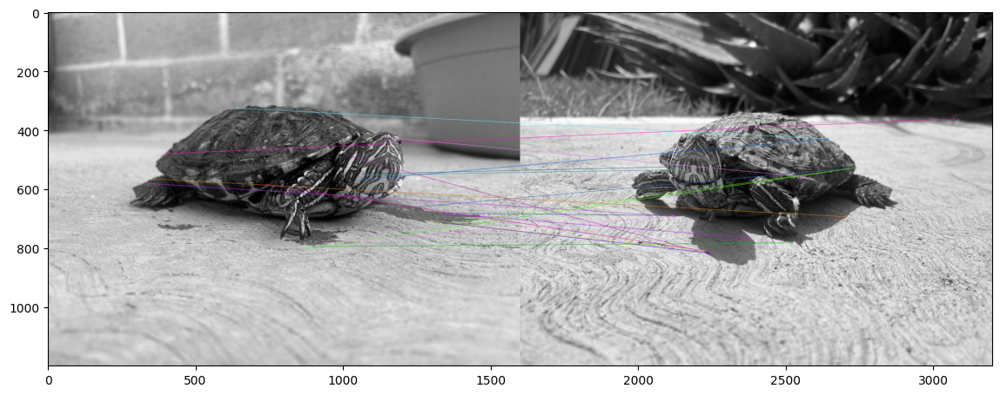

(<matplotlib.image.AxesImage at 0x7af18c2dd2d0>, None)

In [21]:
# Definición de imagen de comparación (query)
img_query = images[4]

# Creación de Descriptores para comparación
sift = cv2.SIFT_create()

keypoints_1, descriptors_1 = sift.detectAndCompute(img_query,None)
keypoints_2, descriptors_2 = sift.detectAndCompute(img_tr,None)

#feature matching
bf = cv2.BFMatcher()

matches = bf.match(descriptors_1,descriptors_2)
matches = sorted(matches, key = lambda x:x.distance)

img_match_SIFT_4 = cv2.drawMatches(img_query, keypoints_1, img_tr, keypoints_2, matches[:20], img_tr, flags=2)
plt.imshow(img_match_SIFT_4),plt.show()

**Comentarios:** Las lineas de coparación no so ndel todo malas hay algunas corectas, pero de nuevo la sombra vuelve a ser detectada.

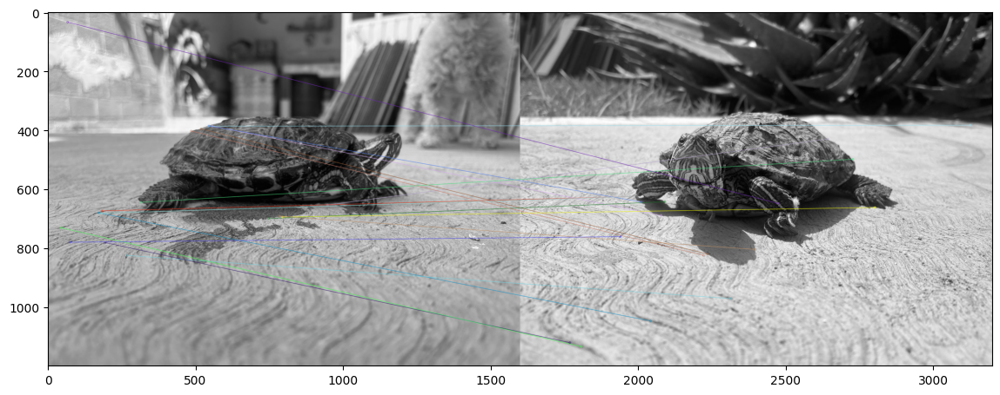

(<matplotlib.image.AxesImage at 0x7af1b019a750>, None)

In [22]:
# Definición de imagen de comparación (query)
img_query = images[5]

# Creación de Descriptores para comparación
sift = cv2.SIFT_create()

keypoints_1, descriptors_1 = sift.detectAndCompute(img_query,None)
keypoints_2, descriptors_2 = sift.detectAndCompute(img_tr,None)

#feature matching
bf = cv2.BFMatcher()

matches = bf.match(descriptors_1,descriptors_2)
matches = sorted(matches, key = lambda x:x.distance)

img_match_SIFT_5 = cv2.drawMatches(img_query, keypoints_1, img_tr, keypoints_2, matches[:20], img_tr, flags=2)
plt.imshow(img_match_SIFT_5),plt.show()

**Comentarios:** El ángulo de la foto influye sobre el analísis y veamos que el contorno de la foto también porque las lineas del concreto también son detectadas.

# Analísis con ORB.

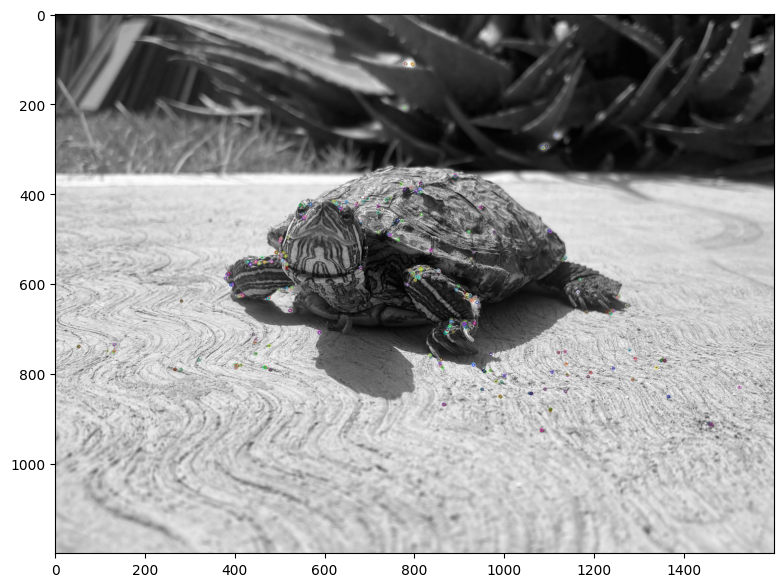

In [35]:
# Definición de imagen de entrenamiento
img_train = images[0]

# Instanciamos el objeto
orb = cv2.ORB_create()
kp, des = orb.detectAndCompute(img_train,None)
# Impresion de resultados.
img_ORB = cv2.drawKeypoints(img_train,kp,img_train)
plt.imshow(img_ORB)

**Comentarios:** A primera vista parece que se detectan muchos menos puntos pero el resto del elementos en la foto son mucho menores.

1er comparación.

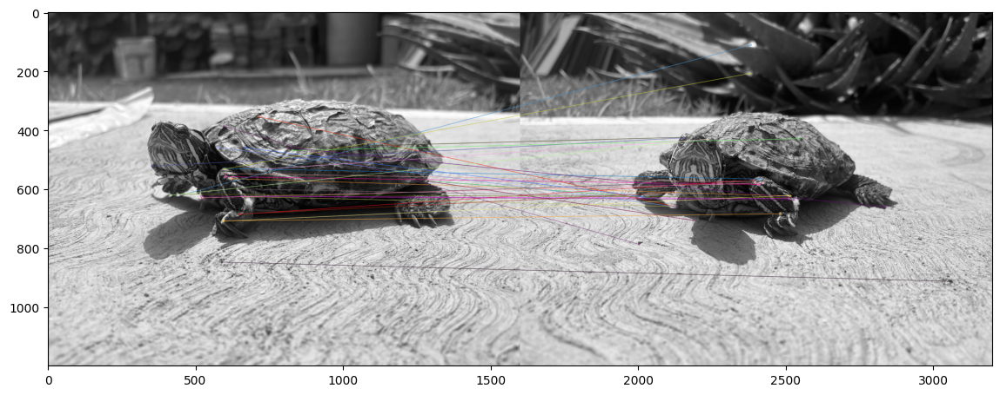

(<matplotlib.image.AxesImage at 0x7af18c0152d0>, None)

In [24]:
# Definición de imagen de comparación (query)
img_query = images[1]

# Creación de Descriptores para comparación
orb = cv2.ORB_create()

keypoints_1, descriptors_1 = orb.detectAndCompute(img_query,None)
keypoints_2, descriptors_2 = orb.detectAndCompute(img_train,None)


#feature matching
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

matches = bf.match(descriptors_1,descriptors_2)
matches = sorted(matches, key = lambda x:x.distance)

img_match_ORB_1 = cv2.drawMatches(img_query, keypoints_1, img_train, keypoints_2, matches[:30], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.imshow(img_match_ORB_1),plt.show()

**Comentarios:** El resultado es bastante preciso. Al ser una imagen con casi la misma pose y entorno las lineas de comparación con correctas.

2da Comparación.

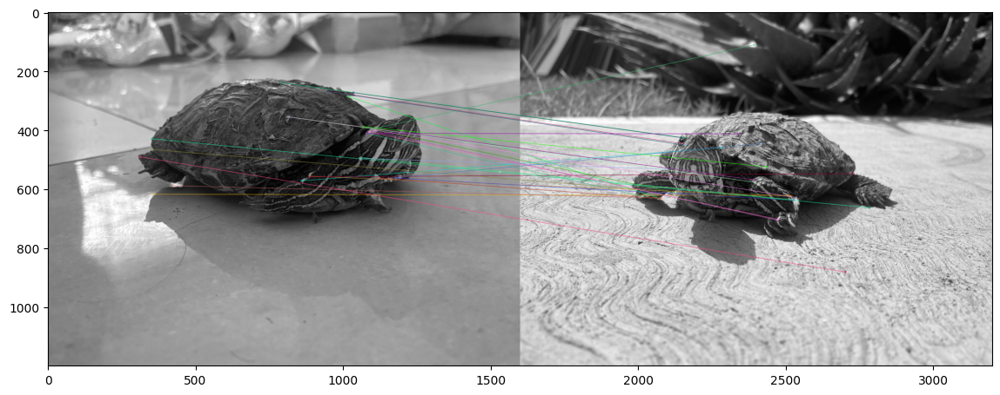

(<matplotlib.image.AxesImage at 0x7af18c197f90>, None)

In [25]:
# Definición de imagen de comparación (query)
img_query = images[2]

# Creación de Descriptores para comparación
orb = cv2.ORB_create()

keypoints_1, descriptors_1 = orb.detectAndCompute(img_query,None)
keypoints_2, descriptors_2 = orb.detectAndCompute(img_train,None)

#feature matching
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

matches = bf.match(descriptors_1,descriptors_2)
matches = sorted(matches, key = lambda x:x.distance)

img_match_ORB_2 = cv2.drawMatches(img_query, keypoints_1, img_train, keypoints_2, matches[:30], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.imshow(img_match_ORB_2),plt.show()

**Comentarios:** Con este método esta imagen mejoró mucho pues se enfocan más los puntos en la propia tortuga.

3ra comperación.

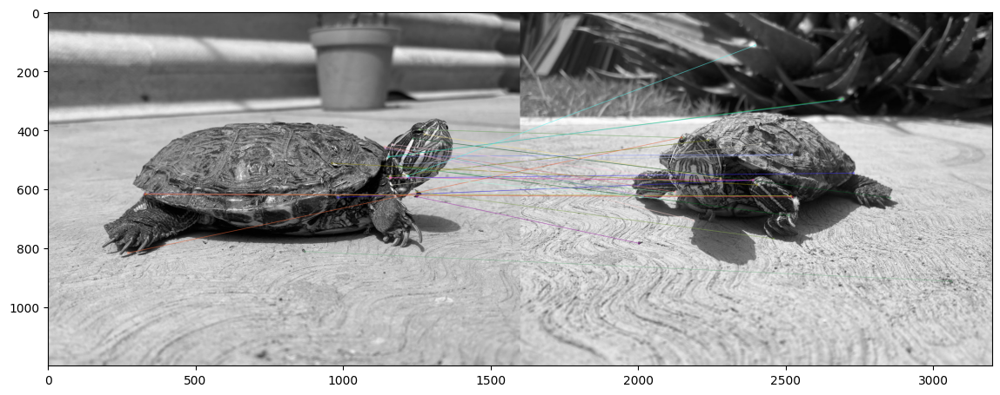

(<matplotlib.image.AxesImage at 0x7af18c09fe50>, None)

In [26]:
# Definición de imagen de comparación (query)
img_query = images[3]

# Creación de Descriptores para comparación
orb = cv2.ORB_create()

keypoints_1, descriptors_1 = orb.detectAndCompute(img_query,None)
keypoints_2, descriptors_2 = orb.detectAndCompute(img_train,None)

#feature matching
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

matches = bf.match(descriptors_1,descriptors_2)
matches = sorted(matches, key = lambda x:x.distance)

img_match_ORB_3 = cv2.drawMatches(img_query, keypoints_1, img_train, keypoints_2, matches[:30], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.imshow(img_match_ORB_3),plt.show()

**Comentarios:** Muchos elementos se relacionan fuera de la tortuga como por ejemplo uno va a dar al piso de concreto y otros dos van a dar a la savila.

4ta Comparación.

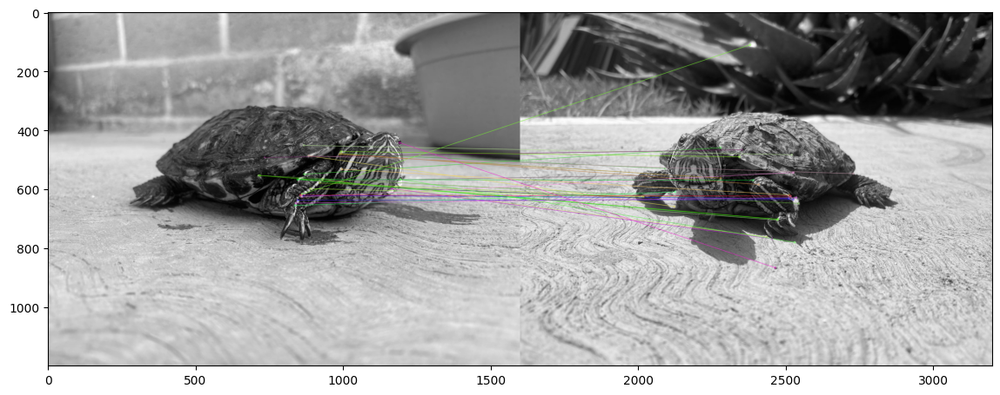

(<matplotlib.image.AxesImage at 0x7af186f09ad0>, None)

In [27]:
# Definición de imagen de comparación (query)
img_query = images[4]

# Creación de Descriptores para comparación
orb = cv2.ORB_create()

keypoints_1, descriptors_1 = orb.detectAndCompute(img_query,None)
keypoints_2, descriptors_2 = orb.detectAndCompute(img_train,None)

#feature matching
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

matches = bf.match(descriptors_1,descriptors_2)
matches = sorted(matches, key = lambda x:x.distance)

img_match_ORB_4 = cv2.drawMatches(img_query, keypoints_1, img_train, keypoints_2, matches[:30], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.imshow(img_match_ORB_4),plt.show()

**Comentarios:** Observamos que a pesar de que una foto tiene mucho menos luz que la otra al estar en la sombra los resultados son buenos salbo un punto que va a dar a la savila.

5ta Comparación.

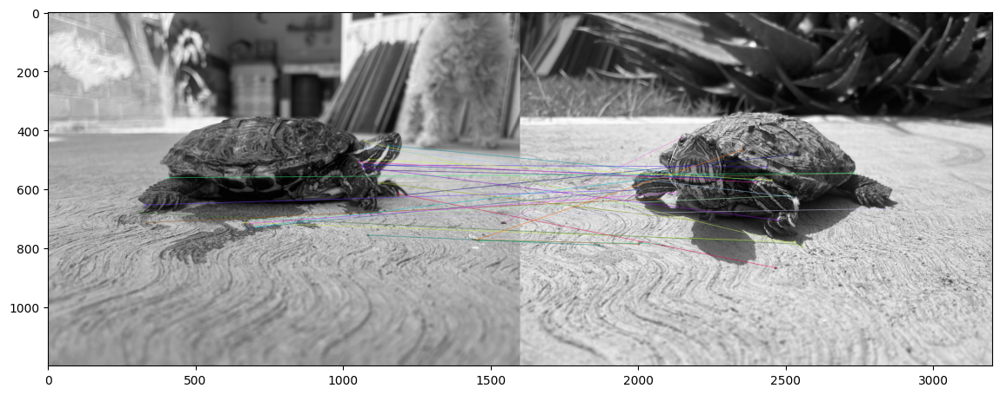

(<matplotlib.image.AxesImage at 0x7af186f73a50>, None)

In [28]:
# Definición de imagen de comparación (query)
img_query = images[5]

# Creación de Descriptores para comparación
orb = cv2.ORB_create()

keypoints_1, descriptors_1 = orb.detectAndCompute(img_query,None)
keypoints_2, descriptors_2 = orb.detectAndCompute(img_train,None)

#feature matching
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

matches = bf.match(descriptors_1,descriptors_2)
matches = sorted(matches, key = lambda x:x.distance)

img_match_ORB_5 = cv2.drawMatches(img_query, keypoints_1, img_train, keypoints_2, matches[:30], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.imshow(img_match_ORB_5),plt.show()

**Comentarios:** Cuando la imagen no tiene el mismo angulo esto causa discrepancias.

# Analisís de comparaciones.

Text(0.5, 1.0, 'ORB')

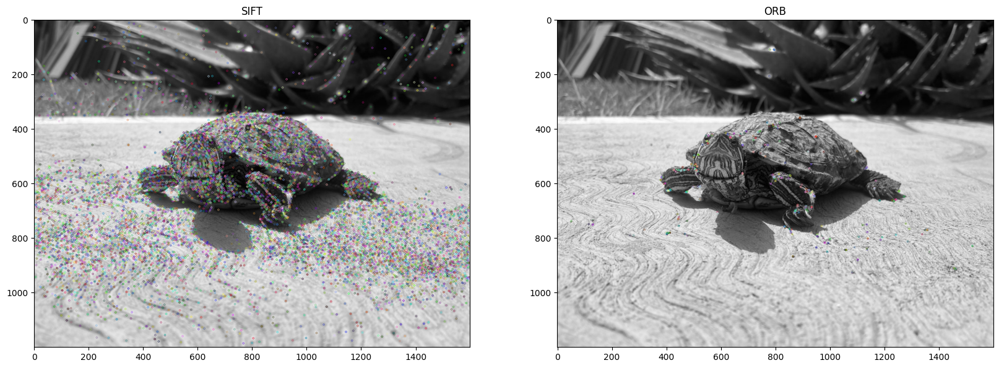

In [29]:
# Comparación entre keypoints SIFT y ORB
plt.figure(figsize=(20, 20))

plt.subplot(1, 2, 1)
plt.imshow(img_SIFT, cmap ="gray")
plt.title("SIFT")
plt.subplot(1, 2, 2)
plt.imshow(img_ORB, cmap="gray")
plt.title("ORB")

**Comentarios:**

Apartir de este punto se realizan comparaciones directas entre `SIFT` y `ORB` son de las mismas imagenes que ya detallamos y comentamos anteriormente, solo que hacemos el contraste comparativo entre ellas para ver un método contra otro.

Text(0.5, 1.0, 'ORB')

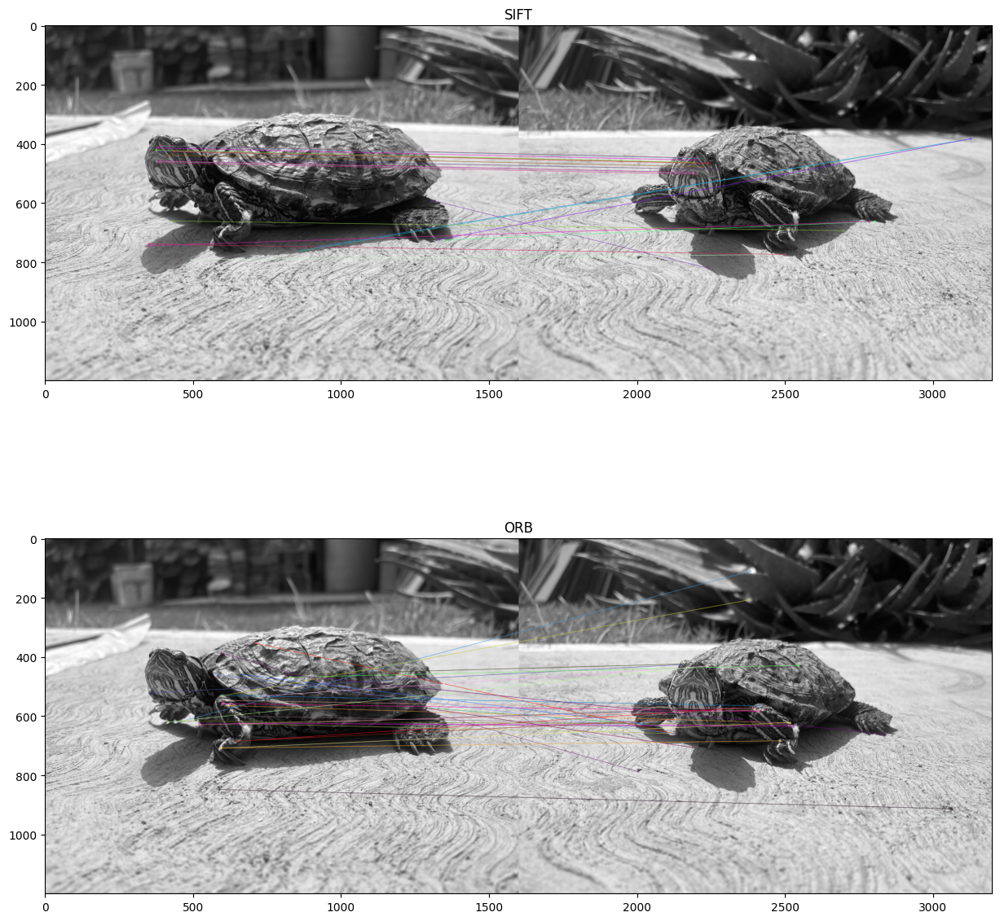

In [30]:
# Comparación entre Feature Matching 1
plt.figure(figsize=(15, 15))

plt.subplot(2, 1, 1)
plt.imshow(img_match_SIFT_1, cmap ="gray")
plt.title("SIFT")
plt.subplot(2, 1, 2)
plt.imshow(img_match_ORB_1, cmap="gray")
plt.title("ORB")

Text(0.5, 1.0, 'ORB')

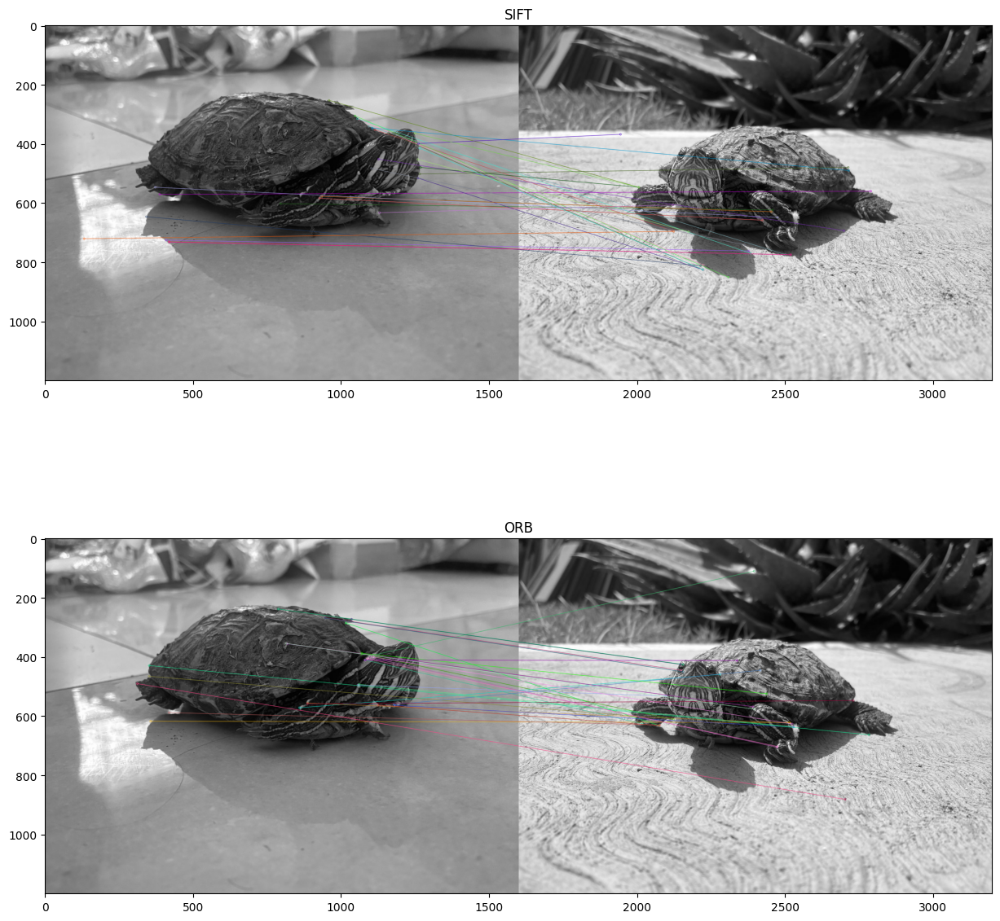

In [31]:
# Comparación entre Feature Matching 2
plt.figure(figsize=(15, 15))

plt.subplot(2, 1, 1)
plt.imshow(img_match_SIFT_2, cmap ="gray")
plt.title("SIFT")
plt.subplot(2, 1, 2)
plt.imshow(img_match_ORB_2, cmap="gray")
plt.title("ORB")

Text(0.5, 1.0, 'ORB')

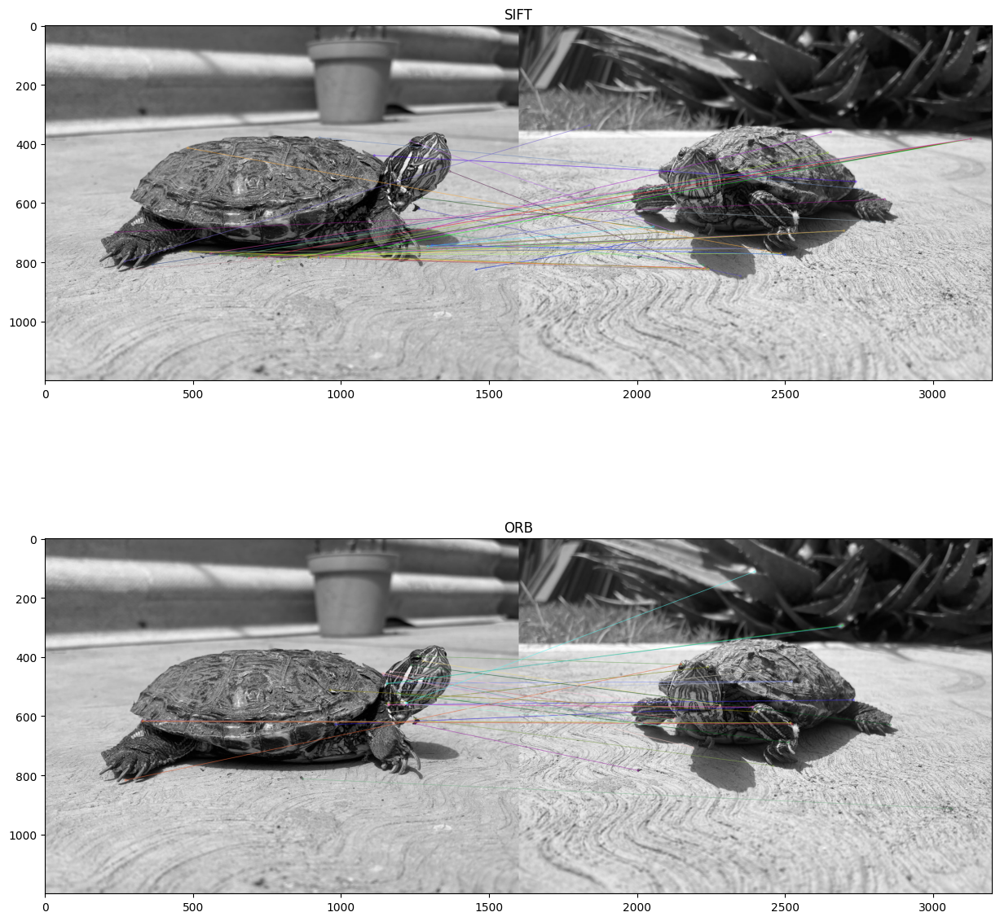

In [32]:
# Comparación entre Feature Matching 3
plt.figure(figsize=(15, 15))

plt.subplot(2, 1, 1)
plt.imshow(img_match_SIFT_3, cmap ="gray")
plt.title("SIFT")
plt.subplot(2, 1, 2)
plt.imshow(img_match_ORB_3, cmap="gray")
plt.title("ORB")

Text(0.5, 1.0, 'ORB')

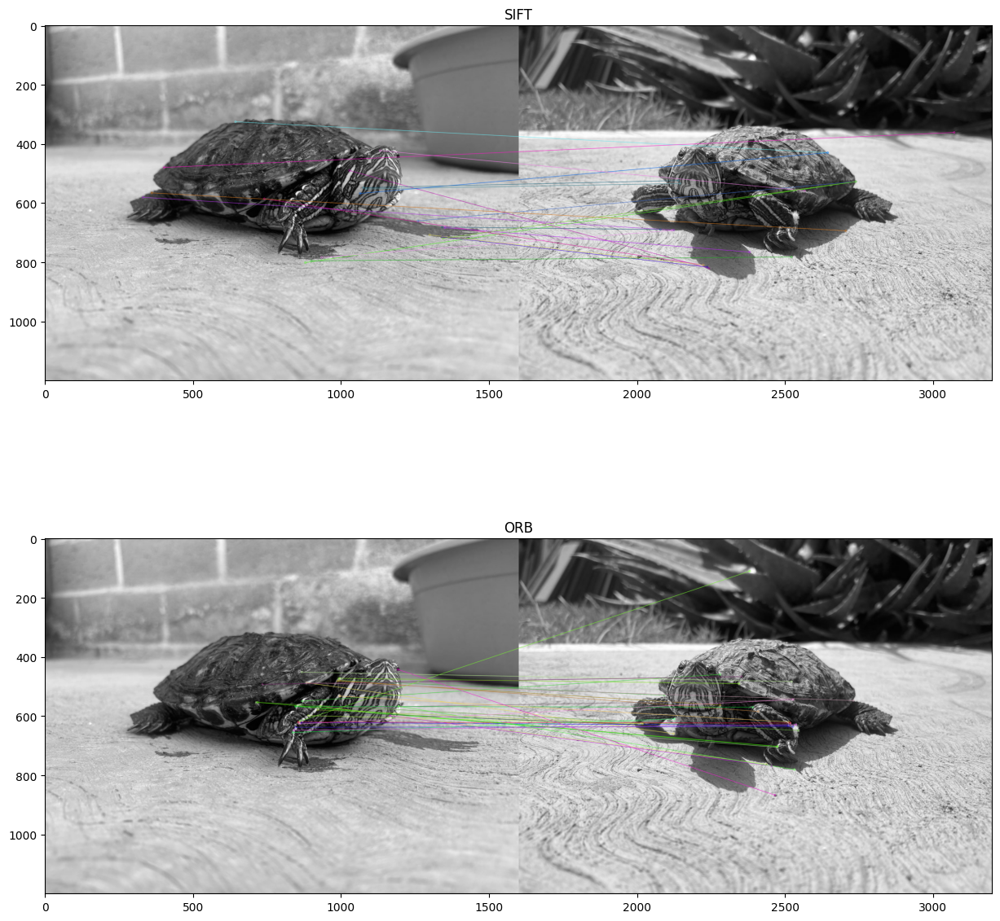

In [33]:
# Comparación entre Feature Matching 4
plt.figure(figsize=(15, 15))

plt.subplot(2, 1, 1)
plt.imshow(img_match_SIFT_4, cmap ="gray")
plt.title("SIFT")
plt.subplot(2, 1, 2)
plt.imshow(img_match_ORB_4, cmap="gray")
plt.title("ORB")

Text(0.5, 1.0, 'ORB')

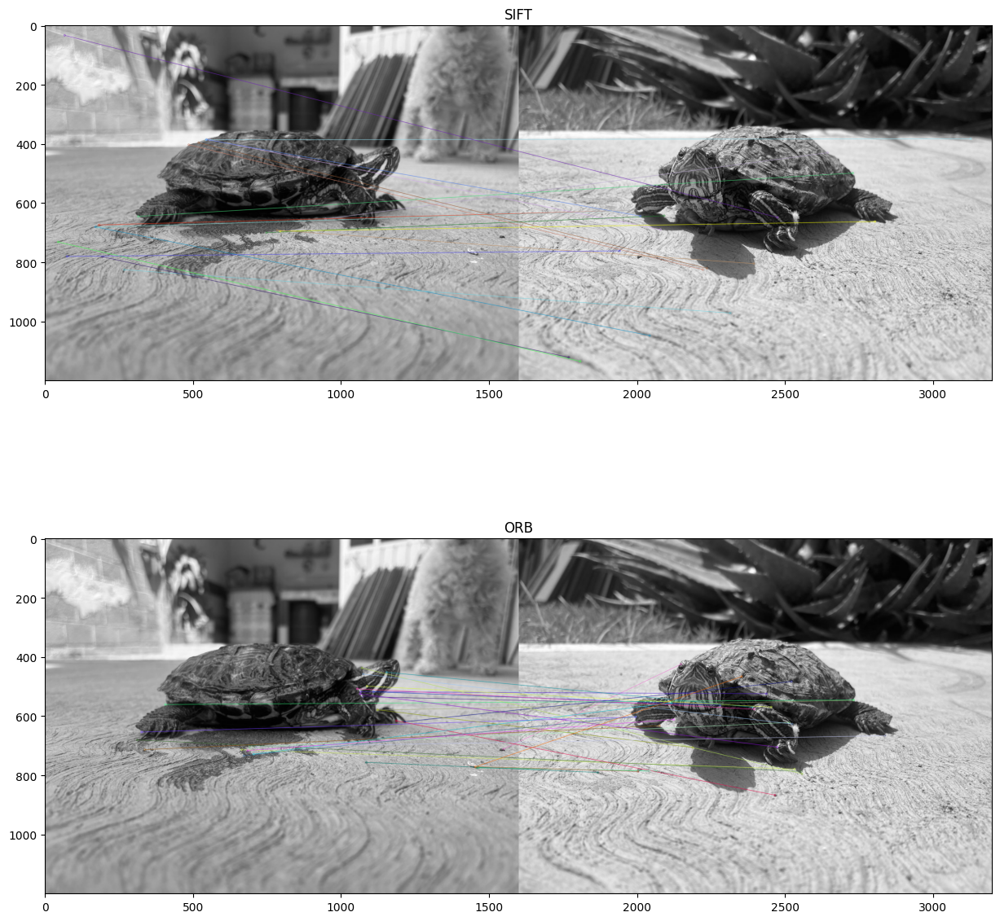

In [34]:
# Comparación entre Feature Matching 4
plt.figure(figsize=(15, 15))

plt.subplot(2, 1, 1)
plt.imshow(img_match_SIFT_5, cmap ="gray")
plt.title("SIFT")
plt.subplot(2, 1, 2)
plt.imshow(img_match_ORB_5, cmap="gray")
plt.title("ORB")

# Referencias:
(Pendiente)